please enter the file name : target-noname.dat


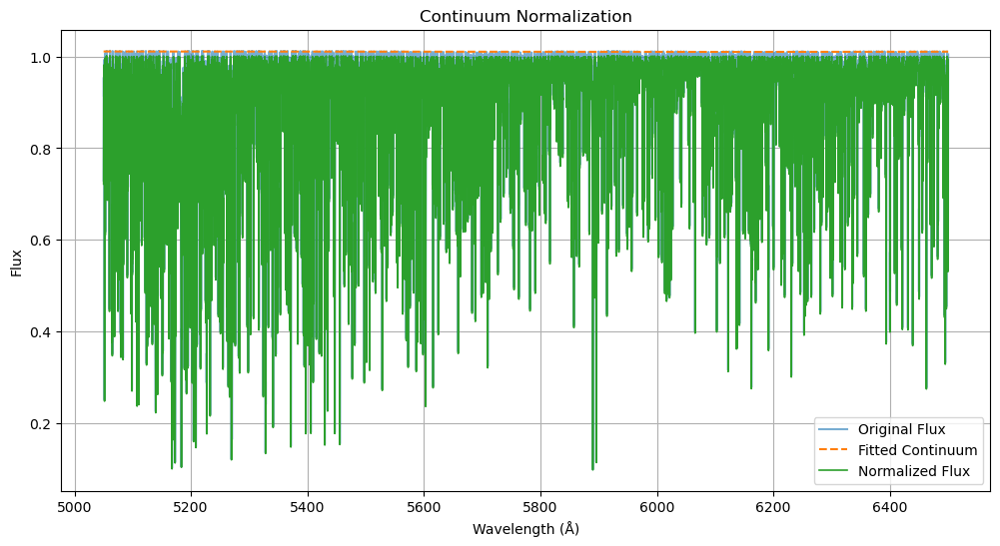

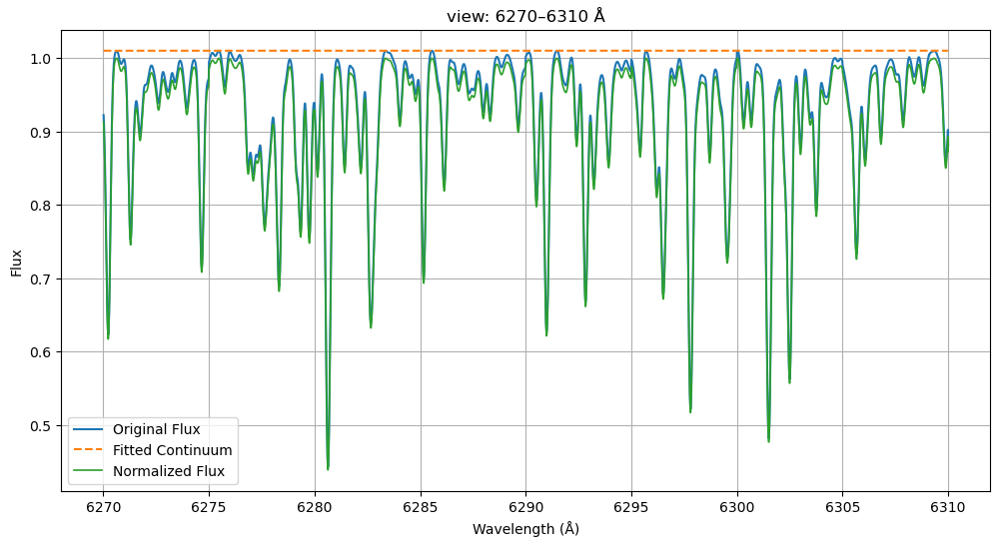

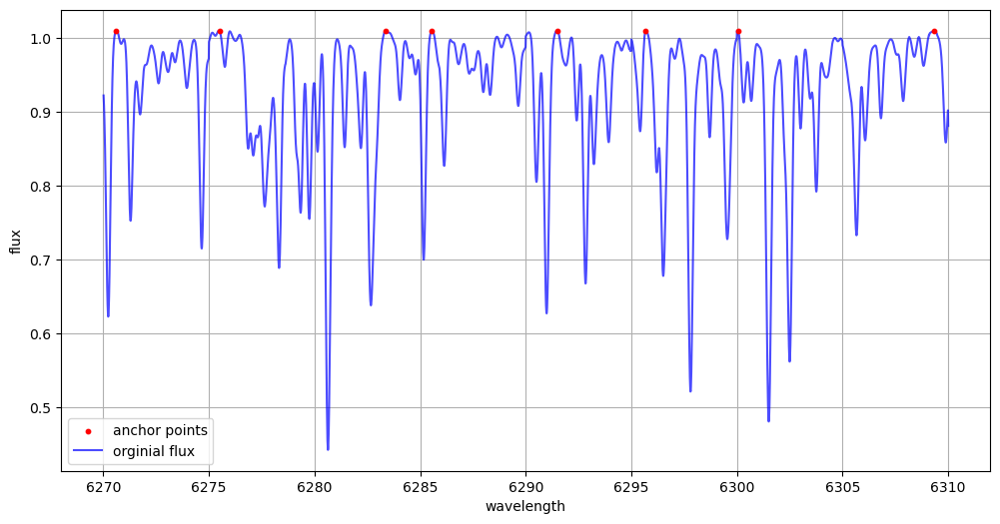

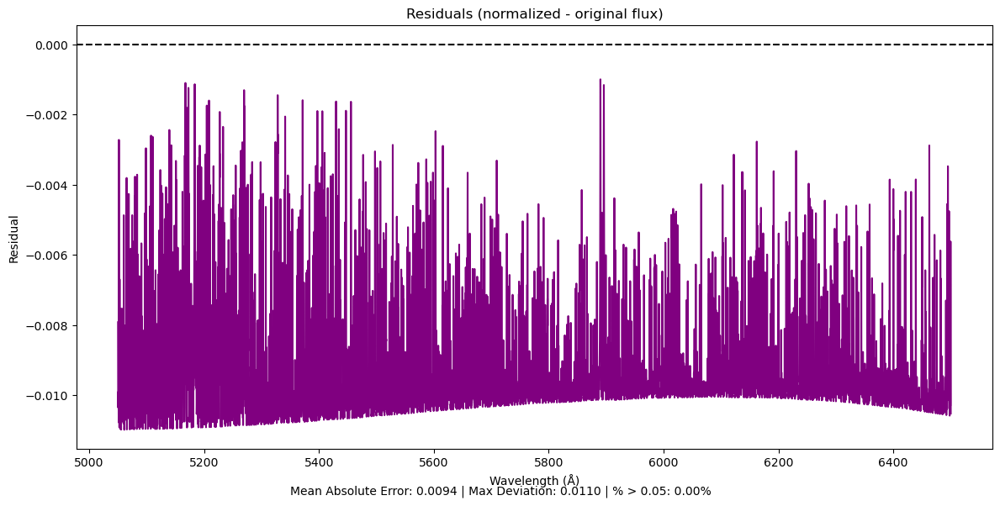

In [2]:
#task 1
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import sigmaclip
from scipy.signal import savgol_filter
from scipy.interpolate import interp1d
from scipy.interpolate import CubicSpline
from scipy.interpolate import UnivariateSpline
from astropy import units as u
%matplotlib inline

# 1. Load the observed spectra file
file_name = input('please enter the file name :')
data_obs = np.loadtxt(file_name)
wl_obs = np.array(data_obs[:,0])
flux_obs = np.array(data_obs[:,1])

#2. load synthetic spectra file 
data_syn = np.loadtxt('m05t4000g3.0_0.spc.r00')
flux_syn = np.array(data_syn[:,1])
wl_syn = np.array(data_syn[:,0])

# Maximum and minimum value of wavelength
wl_max = np.max(wl_obs)
wl_min = np.min(wl_obs)

# Bin width
bin_width = 5
bin_edges = np.arange(wl_min, wl_max+bin_width, bin_width)

# Defining a dataframe and binning
df = pd.DataFrame({'wl': wl_obs, 'flux': flux_obs})
df['wl_bins'] = pd.cut(df['wl'], bins=bin_edges)

anchor_wl = []
anchor_flux = []

# Group by wavelength bins
grouped = df.groupby('wl_bins',observed='bool')

for bin_range, group in grouped:
    bin_flux = group['flux'].values
    bin_wl = group['wl'].values  
    
    if len(bin_flux) == 0:
        continue
    
    min_noise = np.inf
    best_wl, best_flux = None, None
    for p in np.arange(96, 99.9, 1.0):
        
        clipped_data = sigmaclip(bin_flux, low=2.0, high=3.0)[0]
        
        
        if len(clipped_data) == 0:
            continue
        
        target_flux = np.percentile(clipped_data, p)
        idx = np.argmin(np.abs(bin_flux - target_flux))
        try_wl = bin_wl[idx]  
        try_flux = bin_flux[idx]  

        if try_flux < 0.99 :
            continue 
        # Calculate local normalization
        local_norm = bin_flux/try_flux
        smoothed = savgol_filter(local_norm, min(11, len(local_norm) - (len(local_norm) % 2) - 1), 3)
        noise = np.std(local_norm - smoothed)
        
        if noise < min_noise:
            min_noise = noise  
            best_wl, best_flux = try_wl, try_flux
    
    if best_wl is not None:
        anchor_wl.append(best_wl)
        anchor_flux.append(best_flux)

if len(anchor_wl) >= 3:  
    sorted_indices = np.argsort(anchor_wl)
    anchor_wl = np.array(anchor_wl)[sorted_indices]
    anchor_flux = np.array(anchor_flux)[sorted_indices]
    s = len(anchor_wl)*1e-6
    spline_fit = UnivariateSpline( anchor_wl,anchor_flux ,s=s)
    continuum = spline_fit(wl_obs)
    normalized_flux = flux_obs/continuum

    
plt.figure(figsize=(12, 6))
plt.plot(wl_obs, flux_obs, label='Original Flux', alpha=0.6)
plt.plot(wl_obs, continuum, label='Fitted Continuum', linestyle='--')
plt.plot(wl_obs, normalized_flux, label='Normalized Flux', linewidth=1.2)
plt.xlabel("Wavelength (Å)")
plt.ylabel("Flux")
plt.legend()
plt.title("Continuum Normalization")
plt.grid(True)
plt.show()


zoom_min, zoom_max = 6270 , 6310

mask = (wl_obs >= zoom_min) & (wl_obs <= zoom_max)
mask1 = (anchor_wl >= zoom_min) & (anchor_wl <= zoom_max)

plt.figure(figsize=(12, 6))
plt.plot(wl_obs[mask], flux_obs[mask], label='Original Flux', alpha=1.0, )
plt.plot(wl_obs[mask], continuum[mask], label='Fitted Continuum', linestyle='--')
plt.plot(wl_obs[mask], normalized_flux[mask], label='Normalized Flux', linewidth=1.2)
plt.xlabel("Wavelength (Å)")
plt.ylabel("Flux")
plt.legend()
plt.title(f"view: {zoom_min}–{zoom_max} Å")
plt.grid(True)
plt.show()

plt.figure(figsize=(12,6))
plt.scatter(anchor_wl[mask1] , anchor_flux[mask1] , label='anchor points' , s=10 , zorder=5, color ='red')
plt.plot(wl_obs[mask], flux_obs[mask] , label='orginial flux' , color='blue' , alpha = 0.7 )
plt.xlabel("wavelength")
plt.ylabel("flux")
plt.legend()
plt.grid(True)
plt.show()


interp_func=interp1d(wl_syn , flux_syn , kind='linear', bounds_error='false' , fill_value='extrapolate ')
synth_flux_interp= interp_func(wl_obs)


# Residuals
residuals = normalized_flux - flux_obs
abs_error = np.abs(residuals)



# Plot 2: Residuals
plt.figure(figsize=(12,6))
plt.plot(wl_obs, residuals, color='purple')
plt.axhline(0, color='black', linestyle='--')
plt.title("Residuals (normalized - original flux)")
plt.xlabel("Wavelength (Å)")
plt.ylabel("Residual")





mean_err = np.mean(abs_error)
max_err = np.max(np.abs(residuals))
above_thresh = np.sum(abs_error > 0.05) / len(abs_error) * 100  # example threshold

plt.tight_layout()
plt.figtext(0.5, 0.01, f"Mean Absolute Error: {mean_err:.4f} | Max Deviation: {max_err:.4f} | % > 0.05: {above_thresh:.2f}%", 
            wrap=True, horizontalalignment='center', fontsize=10)
plt.show()


Analyzing section 1/10: 5050.00 - 5194.99 Å


/var/folders/0f/nc1mz1tx1ds7v1shbvzf44800000gn/T/ipykernel_38634/2467329791.py:209: UserWarning: The figure layout has changed to tight
  plt.tight_layout()



Analyzing section 2/10: 5195.00 - 5339.99 Å

Analyzing section 3/10: 5340.00 - 5484.99 Å

Analyzing section 4/10: 5485.00 - 5629.99 Å

Analyzing section 5/10: 5630.00 - 5774.98 Å

Analyzing section 6/10: 5774.99 - 5919.98 Å

Analyzing section 7/10: 5919.99 - 6064.98 Å

Analyzing section 8/10: 6064.99 - 6209.98 Å

Analyzing section 9/10: 6209.99 - 6354.98 Å

Analyzing section 10/10: 6354.99 - 6500.00 Å

Results:
Average Resolving Power: 19798
Median Resolving Power: 21662

Best high-quality resolving power: 26037
At wavelength: 6280.639771 Å with FWHM: 0.241216 Å
Fit quality (R²): 0.956

Average resolving power from 24 validated lines: 18896 ± 4856


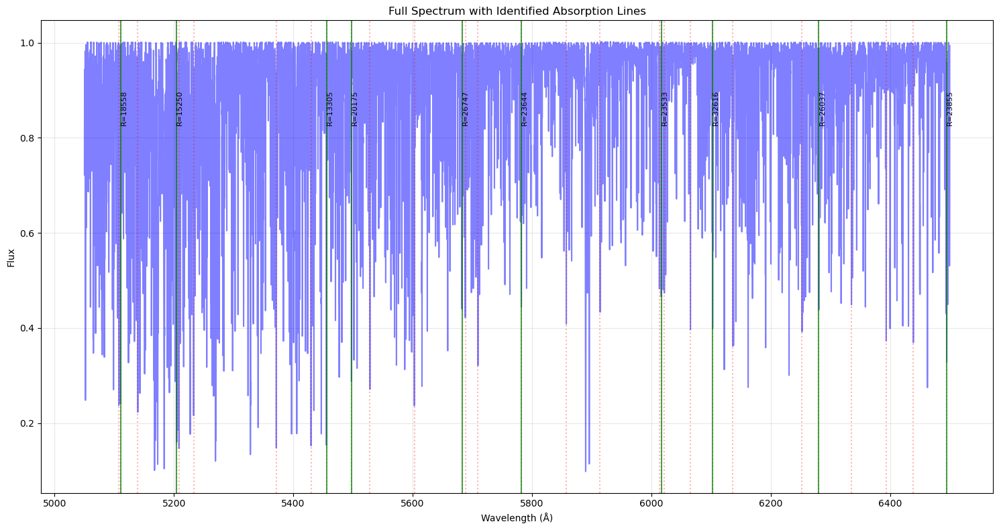

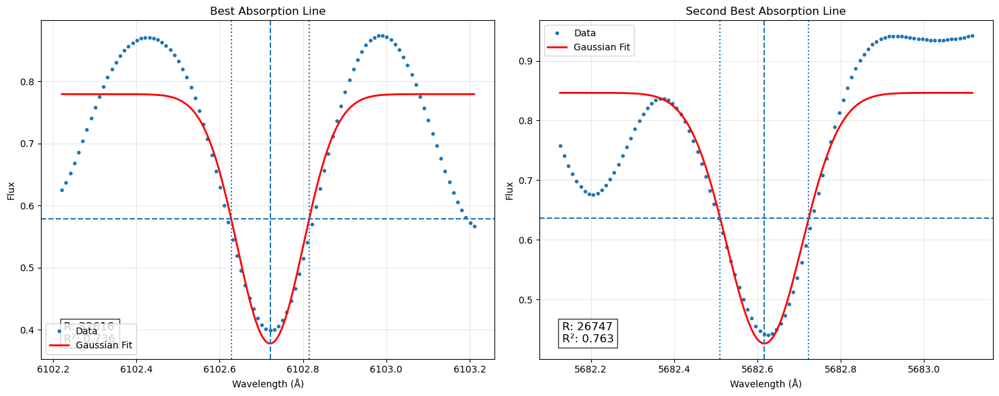

In [4]:
#Task 2 - Determining the resolving power for observed spectra 
from scipy.signal import savgol_filter, find_peaks, peak_prominences
from scipy.optimize import curve_fit
from scipy.signal import fftconvolve, peak_widths
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# define an inverted gaussian function
def gaussian(x, a, c, x0, sigma):
    '''Here a=amplitude, x0=centre of gaussian, c=continuum level, sigma=standard deviation'''
    return c - a*np.exp(-(x-x0)**2 / (2*sigma**2))  

#----------------------------------------------------------------------------------------------------------------
#define a function to analyze the section of the spectrum with quality check 
def analyze_spectrum(wl_section, flux_section, section_num):
    #data smoothing 
    valid_peaks = []
    try:
        smoothed_flux = savgol_filter(flux_section, window_length=11, polyorder=3)
    except:
        smoothing_window = 5
        smoothed_flux = fftconvolve(flux_section, np.ones(smoothing_window)/smoothing_window, mode='same')
    
    #inverting the flux to assume the absorption/emission lines as peaks
    flux_range = np.max(smoothed_flux) - np.min(smoothed_flux)
    if flux_range < 0.01:  
        print(f'Section {section_num} is flat, skipped!!')
        return None  
    
   
    inv_flux = 1 - flux_section
    
    #rough calculation of parameters for peak detection
    #initial rough peaks
    noise_level = np.std(inv_flux)
    clip_noise_frac = 3
    prom_rough = noise_level * clip_noise_frac
    
    # Fixed variable name consistency
    peaks_r, _ = find_peaks(inv_flux, prominence=prom_rough)
    if len(peaks_r) < 2:
        prom_rough = noise_level * (clip_noise_frac/2)  
        peaks_r, _ = find_peaks(inv_flux, prominence=prom_rough)
    
    #distance parameter   
    if len(peaks_r) > 1:
        mean_sp = np.mean(np.diff(wl_section[peaks_r]))  
        dx = np.median(np.diff(wl_section))  
        dist = max(1, int(0.5 * (mean_sp/dx)))
    else:
        dist = 5  # Default value if not enough peaks
        
    #width parameter
    if len(peaks_r) > 0:
        width_r = peak_widths(inv_flux, peaks_r, rel_height=0.5)[0]
        min_w, max_w = np.percentile(width_r, [10, 90])
    else:
        min_w, max_w = 3, 15
    
    #prominence parameter
    candidate_peaks, _ = find_peaks(inv_flux, distance=dist, width=(min_w, max_w))
    
    # Use the peak_prominences function to calculate prominences
    if len(candidate_peaks) > 0:
        prominences = peak_prominences(inv_flux, candidate_peaks)[0]
        
        # Get peaks with sufficient prominence
        final_peaks = []
        for i, peak in enumerate(candidate_peaks):
            if prominences[i] >= noise_level*clip_noise_frac:
                final_peaks.append(peak)
    else:
        final_peaks = []
    
    peak_indices = final_peaks
    
    if len(peak_indices) == 0:
        print(f'No significant absorption line found in section {section_num}')
    
    #verify that each candidate peak is a "real" absorption line of sufficient depth
    min_depth = 0.05 
    for i in peak_indices:
        rel_depth = inv_flux[i]
        if rel_depth >= min_depth: 
            valid_peaks.append((i, rel_depth))
    
    if not valid_peaks:
        print(f'No absorption lines deeper than {min_depth*100:.1f}% were found.')
        return None
        
    # Sort valid_peaks by depth (descending)
    valid_peaks.sort(key=lambda x: x[1], reverse=True)  
    
    results = []
    
    avg_steps = 0.01  # Wavelength step size
    continuum = np.mean(spline_fit(wl_obs))  
    
    fig, axs = plt.subplots(1, min(3, len(valid_peaks)), figsize=(15, 5), constrained_layout=True)
    if len(valid_peaks) == 1:
        axs = [axs]
    elif len(valid_peaks) == 0:
        return None
        
    for i in range(min(3, len(valid_peaks))):
        idx, depth = valid_peaks[i]
        window = 50
        left_idx = max(0, idx-window)
        right_idx = min(len(wl_section), idx+window)
        line_wl = wl_section[left_idx:right_idx]
        line_flux = flux_section[left_idx:right_idx]
        
        if len(line_wl) < 10:  # Fixed condition (was: line_wl < 10)
            print(f'Not enough points for fitting peak at {wl_section[idx]}')
            continue
            
        centre_wave = wl_section[idx]
        amplitude = continuum - np.min(line_flux)
        half_depth = line_flux[idx-left_idx] + amplitude/2
        
        left_half_idx = right_half_idx = idx-left_idx
        
        for j in range(idx-left_idx, 0, -1):
            if line_flux[j] >= half_depth:
                left_half_idx = j
                break
                
        for k in range(idx-left_idx, len(line_flux)-1):
            if line_flux[k] >= half_depth:  
                right_half_idx = k
                break
                
        measured_fwhm = max(line_wl[right_half_idx] - line_wl[left_half_idx], avg_steps*3)
        sigma_guess = measured_fwhm / 2.3548
        
        p0 = [amplitude, continuum, centre_wave, sigma_guess]
        
        try:
            lower_bounds = [0, 0, line_wl[0], avg_steps]
            upper_bounds = [amplitude*2, continuum*2, line_wl[-1], (line_wl[-1] - line_wl[0])/2]
            
            popt, pcov = curve_fit(gaussian, line_wl, line_flux, p0=p0, bounds=(lower_bounds, upper_bounds))
            
            # Unpack fitted parameters properly
            amp_fit, cont_fit, centre_fit, sigma_fit = popt
            
            fwhm = sigma_fit * 2.3548
            resolving_power = centre_fit / fwhm  
            
            residuals = line_flux - gaussian(line_wl, *popt)
            ss_residuals = np.sum(residuals**2)
            ss_total = np.sum((line_flux - np.mean(line_flux))**2) 
            r_squared = 1 - (ss_residuals / ss_total if ss_total > 0 else 0)
            
            results.append({
                'center': centre_fit, 
                'sigma': sigma_fit, 
                'fwhm': fwhm,
                'resolving_power': resolving_power,  
                'amplitude': amp_fit,  
                'continuum': cont_fit,  
                'r_squared': r_squared, 
                'line_wl': line_wl, 
                'line_flux': line_flux
            })
            kit = pd.DataFrame(results)
            kit.to_csv(" Observed_file.csv",index=False)
            # Handle plotting
            if i < len(axs):
                ax = axs[i]
                ax.plot(line_wl, line_flux, 'o', markersize=3, label='data')
                
                x_fit = np.linspace(line_wl[0], line_wl[-1], 1000)
                y_fit = gaussian(x_fit, *popt)
                ax.plot(x_fit, y_fit, 'r-', label='fit')
                
                half_depth = cont_fit - amp_fit/2
                half_width = sigma_fit * np.sqrt(2 * np.log(2))
                left_half = centre_fit - half_width
                right_half = centre_fit + half_width
                
                # Fixed string interpolation
                ax.axvline(x=centre_fit, color='green', linestyle='--')
                ax.axhline(y=half_depth, color='blue', linestyle='--')  
                ax.axvline(x=left_half, color='purple', linestyle=':')
                ax.axvline(x=right_half, color='red', linestyle=':')
               
                # Add resolving power to title
                ax.set_title(f"λ={centre_fit:.2f}Å, R={resolving_power:.0f}")
                ax.set_xlabel('Wavelength (Å)')
                ax.set_ylabel('Flux')
                ax.grid(alpha=0.3)
                ax.legend(fontsize='small')
                
        except Exception as e:
            print(f"Fitting failed for peak at {wl_section[idx]:.2f} Å: {e}")
            
            # Plot the raw data if fitting failed
            if i < len(axs):
                ax = axs[i]
                ax.plot(line_wl, line_flux, 'o', markersize=3)
                ax.set_title(f"Fitting failed at λ={wl_section[idx]:.2f}Å")
                ax.set_xlabel('Wavelength (Å)')
                ax.set_ylabel('Flux')
                ax.grid(alpha=0.3)
    
    plt.suptitle(f"Section {section_num}: {wl_section[0]:.2f} - {wl_section[-1]:.2f} Å", fontsize=16)
    plt.tight_layout()
    plt.savefig(f'section_{section_num}_peaks.png', dpi=200)
    plt.close()
    
    return results
#--------------------------------------------------------------------------------------------------------------------------------

# Main code to run the analysis 
def run_resolution_analysis(wl_obs, normalized_flux):
    num_sections = 10
    section_size = len(wl_obs) // num_sections
    
    all_results = []
    best_results_per_section = []
    
    for i in range(num_sections):
        start = i*section_size 
        end = (i+1)*section_size if i < num_sections-1 else len(wl_obs)  
        
        wl_section = wl_obs[start:end]
        flux_section = normalized_flux[start:end]
        
        print(f"\nAnalyzing section {i+1}/{num_sections}: {wl_section[0]:.2f} - {wl_section[-1]:.2f} Å")
        
        
        results = analyze_spectrum(wl_section, flux_section, i+1) 
        if results:
            all_results.extend(results)
            
            best_result = max(results, key=lambda x: x['resolving_power'])
            best_results_per_section.append(best_result)
    
    # Create a summary plot
    if all_results:
        plt.figure(figsize=(15,8))
        plt.plot(wl_obs, normalized_flux, 'b-', alpha=0.5)  
        
        # Mark all the identified absorption lines
        for result in all_results:
            plt.axvline(x=result['center'], color='r', alpha=0.3, linestyle=':')
        
        # Mark the best absorption lines more prominently
        for result in best_results_per_section:
            plt.axvline(x=result['center'], color='g', alpha=0.7, linestyle='-', linewidth=1.5)
            plt.text(result['center'], 0.9, f"R={result['resolving_power']:.0f}", 
                     rotation=90, verticalalignment='top', fontsize=8)
        
        plt.xlabel('Wavelength (Å)')
        plt.ylabel('Flux')
        plt.title('Full Spectrum with Identified Absorption Lines')
        plt.grid(alpha=0.3)
        plt.tight_layout()
        plt.savefig('full_spectrum_analysis.png', dpi=300)  # Reduced dpi for faster processing
        
        # Calculate average resolving power
        resolving_powers = [r['resolving_power'] for r in all_results]
        avg_resolving_power = np.mean(resolving_powers)
        median_resolving_power = np.median(resolving_powers)
        print(f"\nResults:")
        print(f"Average Resolving Power: {avg_resolving_power:.0f}")
        print(f"Median Resolving Power: {median_resolving_power:.0f}")
        
        return avg_resolving_power, all_results, best_results_per_section
    else:
        print("No valid absorption lines found for resolving power calculation.")
        return None, [], []
avg_R, all_results, best_results = run_resolution_analysis(wl_obs, normalized_flux)
# ------------------------------------------------------------------------------------------------------------------------
if all_results:
    # sort and get best two
    all_results.sort(key=lambda x: x['resolving_power'], reverse=True)
    best_result = all_results[0]
    second_best_result = all_results[1] if len(all_results) > 1 else None

    fig, axs = plt.subplots(1, 2 if second_best_result else 1, figsize=(15, 6))
    if second_best_result:
        ax1, ax2 = axs
    else:
        ax1 = axs

    # plot best
    wl1 = best_result['line_wl']
    fl1 = best_result['line_flux']
    ax1.plot(wl1, fl1, 'o', markersize=3, label='Data')
    x1 = np.linspace(wl1[0], wl1[-1], 1000)
    y1 = gaussian(x1, best_result['amplitude'], best_result['continuum'],
                  best_result['center'], best_result['sigma'])
    ax1.plot(x1, y1, 'r-', linewidth=2, label='Gaussian Fit')
    hd1 = best_result['continuum'] - best_result['amplitude']/2
    hw1 = best_result['sigma'] * np.sqrt(2 * np.log(2))
    lh1 = best_result['center'] - hw1
    rh1 = best_result['center'] + hw1
    ax1.axvline(x=best_result['center'], linestyle='--')
    ax1.axhline(y=hd1, linestyle='--')
    ax1.axvline(x=lh1, linestyle=':')
    ax1.axvline(x=rh1, linestyle=':')
    ax1.text(0.05, 0.05,
             f"R: {best_result['resolving_power']:.0f}\nR²: {best_result['r_squared']:.3f}",
             transform=ax1.transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.8))
    ax1.set_xlabel('Wavelength (Å)')
    ax1.set_ylabel('Flux')
    ax1.set_title('Best Absorption Line')
    ax1.legend()
    ax1.grid(True, alpha=0.3)

    # plot second best if exists
    if second_best_result:
        wl2 = second_best_result['line_wl']
        fl2 = second_best_result['line_flux']
        ax2.plot(wl2, fl2, 'o', markersize=3, label='Data')
        x2 = np.linspace(wl2[0], wl2[-1], 1000)
        y2 = gaussian(x2, second_best_result['amplitude'],
                      second_best_result['continuum'], second_best_result['center'],
                      second_best_result['sigma'])
        ax2.plot(x2, y2, 'r-', linewidth=2, label='Gaussian Fit')
        hd2 = second_best_result['continuum'] - second_best_result['amplitude']/2
        hw2 = second_best_result['sigma'] * np.sqrt(2 * np.log(2))
        lh2 = second_best_result['center'] - hw2
        rh2 = second_best_result['center'] + hw2
        ax2.axvline(x=second_best_result['center'], linestyle='--')
        ax2.axhline(y=hd2, linestyle='--')
        ax2.axvline(x=lh2, linestyle=':')
        ax2.axvline(x=rh2, linestyle=':')
        ax2.text(0.05, 0.05,
                 f"R: {second_best_result['resolving_power']:.0f}\nR²: {second_best_result['r_squared']:.3f}",
                 transform=ax2.transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.8))
        ax2.set_xlabel('Wavelength (Å)')
        ax2.set_ylabel('Flux')
        ax2.set_title('Second Best Absorption Line')
        ax2.legend()
        ax2.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.savefig('best_absorption_lines.png', dpi=300)

    # summary of high-quality fits
    valid_results = [r for r in all_results if r['r_squared'] > 0.9]
    if valid_results:
        best_valid = valid_results[0]
        print(f"\nBest high-quality resolving power: {best_valid['resolving_power']:.0f}")
        print(f"At wavelength: {best_valid['center']:.6f} Å with FWHM: {best_valid['fwhm']:.6f} Å")
        print(f"Fit quality (R²): {best_valid['r_squared']:.3f}")
    if len(valid_results) > 1:
        avg_r = np.mean([r['resolving_power'] for r in valid_results])
        std_r = np.std([r['resolving_power'] for r in valid_results])
        print(f"\nAverage resolving power from {len(valid_results)} validated lines: {avg_r:.0f} ± {std_r:.0f}")
    
else:
    print("No suitable absorption lines found for resolving power calculation.")

enter the minimum [M/H] value :  -0.8
enter the maximum [M/H] value :  0.8
enter the minimum Teff value :  3000
enter the maximum Teff value :  4000
enter the minimum log(g) value :  1
enter the maximum log(g) value :  4
enter the minimum Vsin(i) value :  0
enter the maximum Vsin(i) :  4


Found 45 matching synthetic spectra files

 processing p00t4000g3.5_0.spc.r01 ... 


/Users/utkarsh8022/test/configuration.py:310: UserWarning: The figure layout has changed to tight
  plt.tight_layout()



Results:
Average Resolving Power: 43397
Median Resolving Power: 50186

 processing p00t4000g4.0_0.spc.r00 ... 

Results:
Average Resolving Power: 40683
Median Resolving Power: 44726

 processing m05t4000g4.0_0.spc.r03 ... 

Results:
Average Resolving Power: 30004
Median Resolving Power: 30048

 processing m05t4000g3.5_0.spc.r02 ... 

Results:
Average Resolving Power: 37172
Median Resolving Power: 34640

 processing m05t4000g4.0_0.spc.r04 ... 

Results:
Average Resolving Power: 25105
Median Resolving Power: 24892

 processing m05t4000g3.5_0.spc.r04 ... 

Results:
Average Resolving Power: 26981
Median Resolving Power: 29469

 processing m05t4000g3.5_0.spc.r03 ... 

Results:
Average Resolving Power: 32509
Median Resolving Power: 32434

 processing m05t4000g4.0_0.spc.r02 ... 

Results:
Average Resolving Power: 35491
Median Resolving Power: 32661

 processing p00t4000g4.0_0.spc.r01 ... 

Results:
Average Resolving Power: 37223
Median Resolving Power: 35772

 processing p00t4000g3.5_0.spc.r

/Users/utkarsh8022/test/configuration.py:202: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1, min(3, len(valid_peaks)), figsize=(15, 5), constrained_layout=True)
/Users/utkarsh8022/test/configuration.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(15,8))



Results:
Average Resolving Power: 30558
Median Resolving Power: 31885

 processing m05t4000g3.0_0.spc.r00 ... 

Results:
Average Resolving Power: 50926
Median Resolving Power: 58321

 processing p00t4000g4.0_0.spc.r04 ... 

Results:
Average Resolving Power: 23996
Median Resolving Power: 23651

 processing p00t4000g3.5_0.spc.r02 ... 

Results:
Average Resolving Power: 36752
Median Resolving Power: 37384

 processing p00t4000g4.0_0.spc.r03 ... 

Results:
Average Resolving Power: 25195
Median Resolving Power: 20806

 processing m05t4000g4.0_0.spc.r00 ... 

Results:
Average Resolving Power: 42726
Median Resolving Power: 41642

 processing m05t4000g3.5_0.spc.r01 ... 

Results:
Average Resolving Power: 43061
Median Resolving Power: 42396

 processing m05t4000g3.5_0.spc.r00 ... 

Results:
Average Resolving Power: 45846
Median Resolving Power: 48878

 processing m05t4000g4.0_0.spc.r01 ... 

Results:
Average Resolving Power: 39796
Median Resolving Power: 38494

 processing p00t4000g4.0_0.spc.r

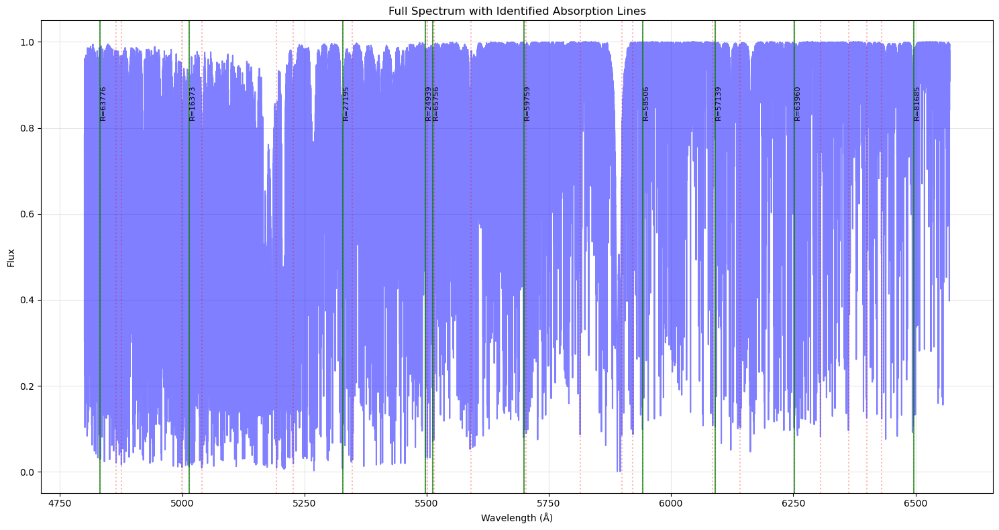

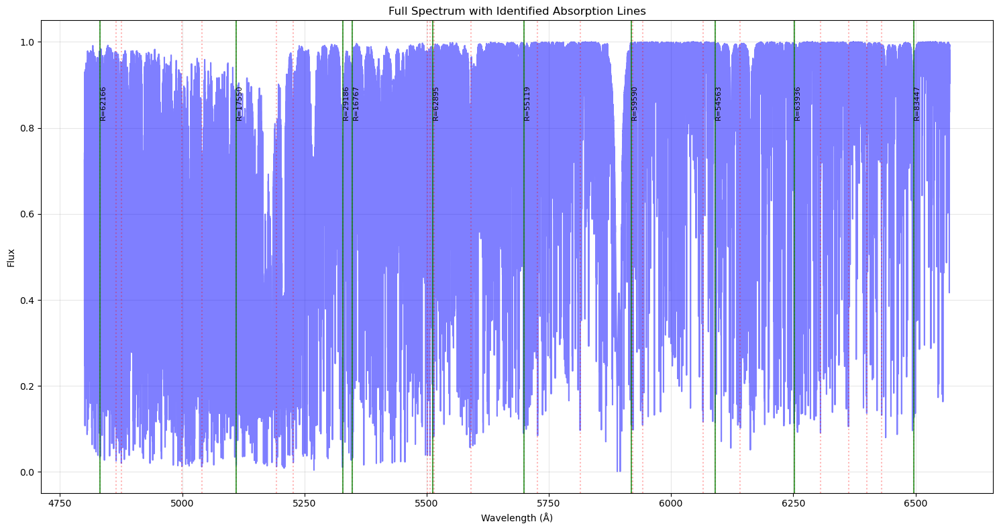

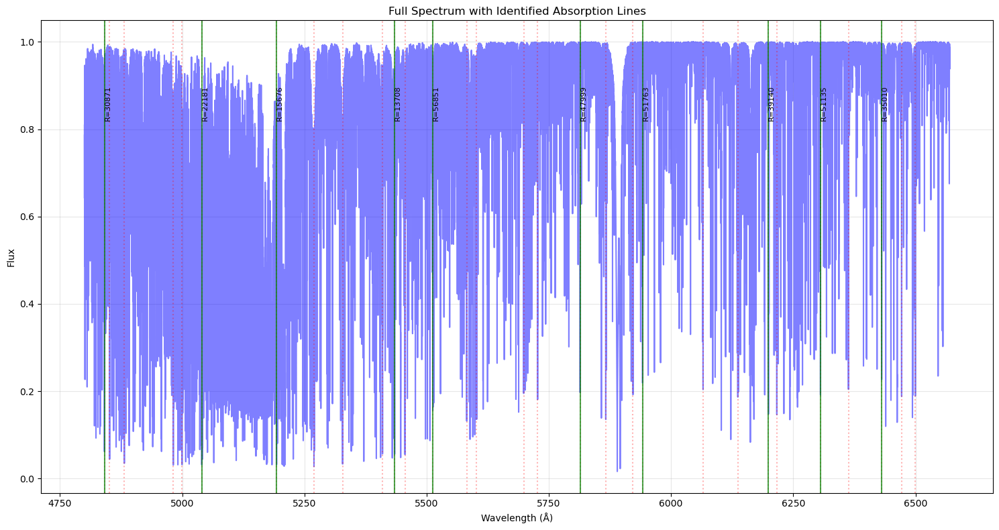

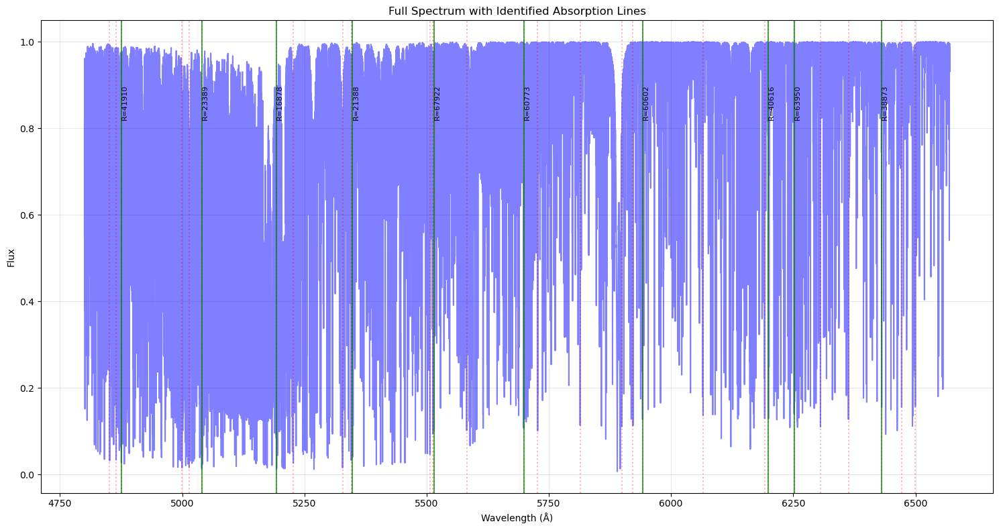

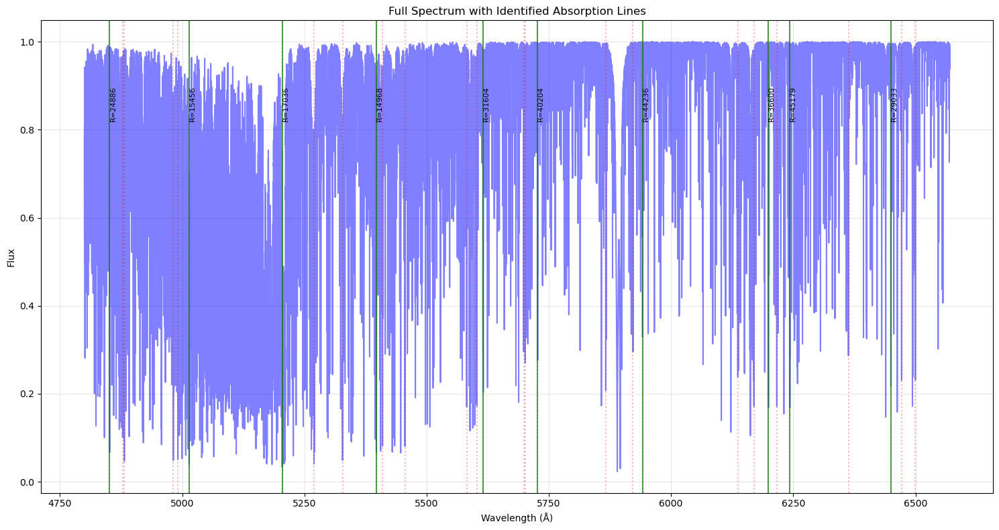

...

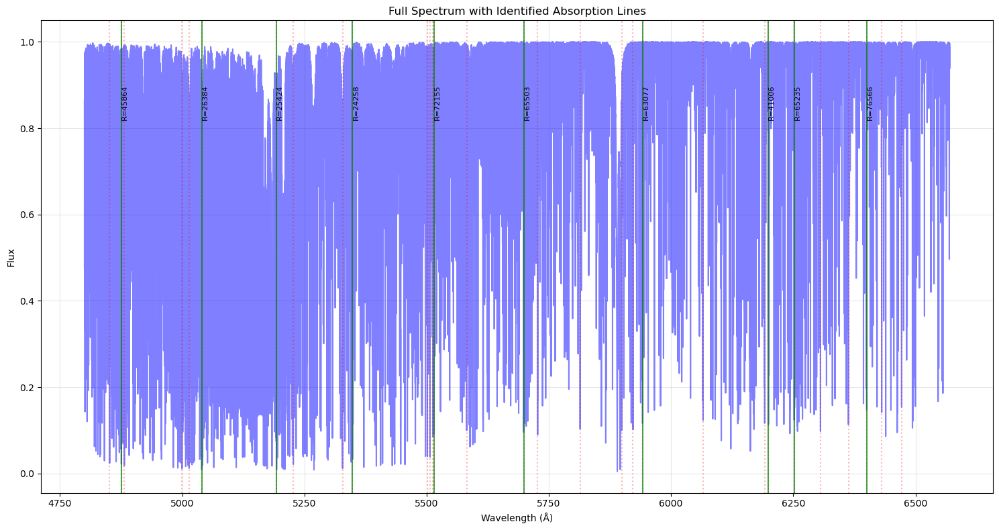

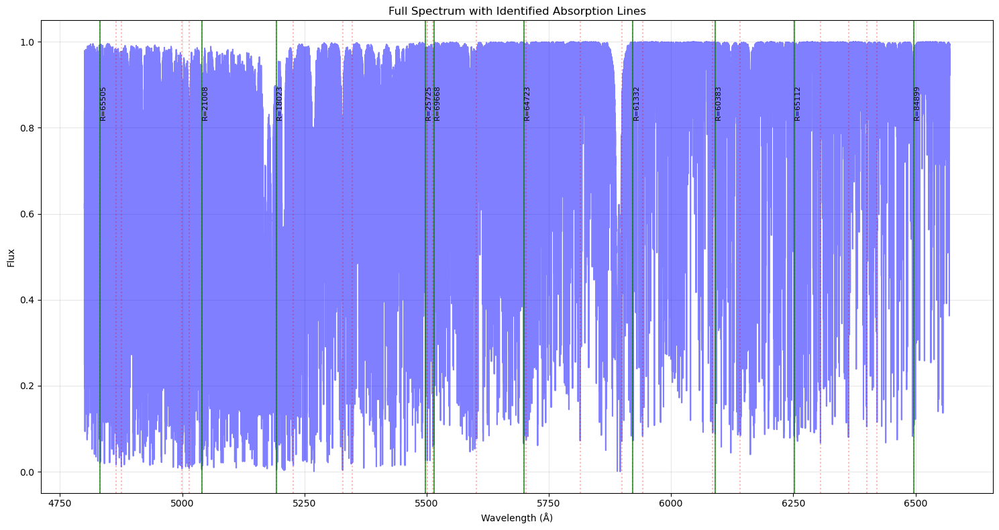

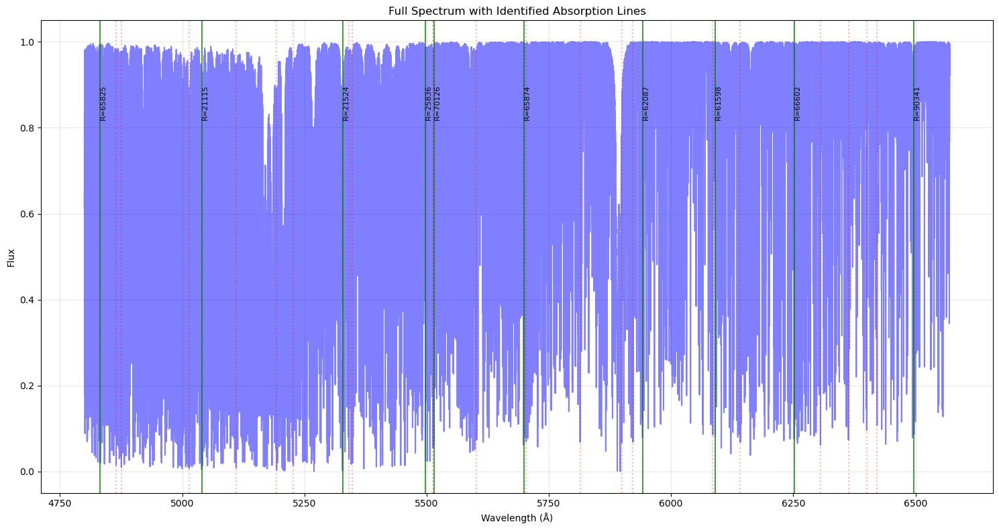

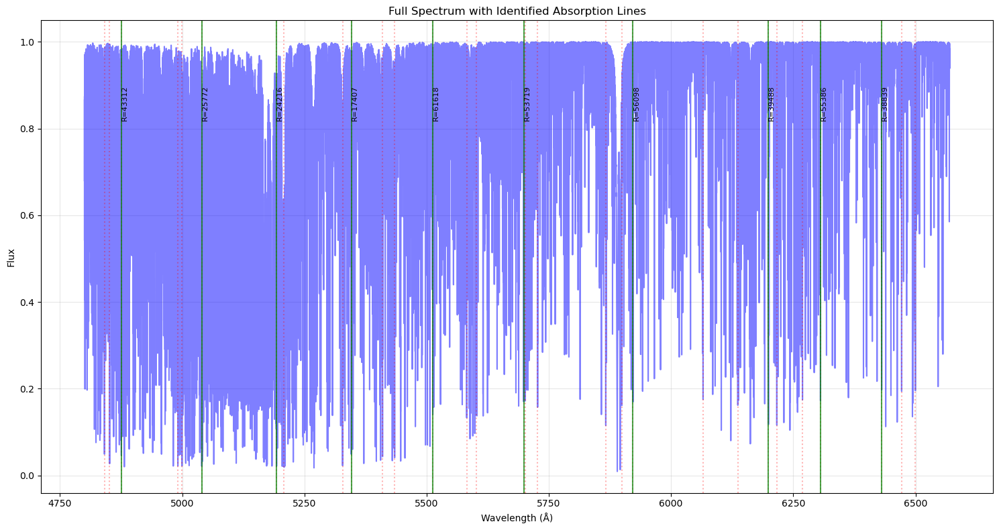

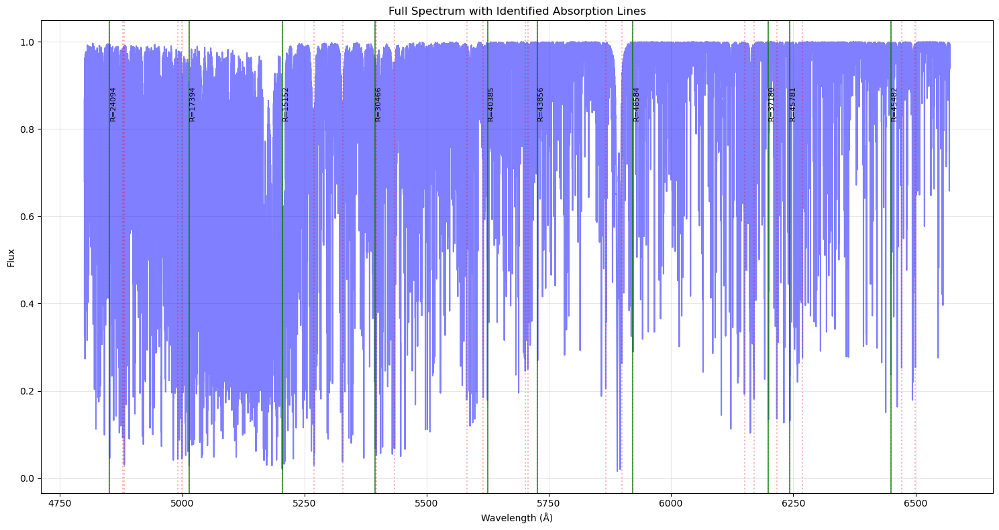

In [6]:
#task 3
import re
import os
from configuration import analyze_spectrum , run_resolution_analysis
import pandas as pd

syn_dir = "synthetic/"


pattern = r'(?P<sign>[pm])(?P<met>\d{2})t(?P<teff>\d{4})g(?P<logg>\d\.\d)(?:_\d+)?\.spc\.r(?P<vsini>\d+)'

def parse_filename(filename):
    match = re.match(pattern, filename)
    if match:
        sign = match.group("sign")
        met_raw = match.group("met")
        met = float(met_raw) / 10.0
        if sign == "m":
            met = -met

        teff = int(match.group("teff"))
        logg = float(match.group("logg"))
        vsini = int(match.group("vsini"))

        return met, teff, logg, vsini
    return None

data = []

for file in os.listdir(syn_dir):
    if re.search(r"\.spc\.r\d+$", file):
        result = parse_filename(file)
        if result:
            met, teff, logg, vsini = result
            data.append({"filename": file, "[M/H]": met, "Teff": teff,"logg": logg, "vsini": vsini})


df = pd.DataFrame(data)
df.to_csv("synthetic_spectra_metadata.csv", index=False)

mh_min = float(input("enter the minimum [M/H] value : "))
mh_max = float(input("enter the maximum [M/H] value : "))
teff_min = int(input("enter the minimum Teff value : "))
teff_max = int(input("enter the maximum Teff value : "))
logg_min = float(input("enter the minimum log(g) value : "))
logg_max = float(input("enter the maximum log(g) value : "))
vsini_min = int(input("enter the minimum Vsin(i) value : "))
vsini_max = int(input("enter the maximum Vsin(i) : "))

filtered_df = df[( df["[M/H]"] >= mh_min) & ( df["[M/H]"] <= mh_max) & (df["Teff"] >= teff_min) & (df["Teff"] <= teff_max) &
(df["logg"] >= logg_min) & (df["logg"] <= logg_max) & (df["vsini"] >= vsini_min) & (df["vsini"] <= vsini_max) ]

filtered_df.to_csv("filtered_spectra.csv",index=False)
selected_files = filtered_df["filename"].to_list()
print(f'Found {len(selected_files)} matching synthetic spectra files')

spline_fit = UnivariateSpline( anchor_wl , anchor_flux , s=len((anchor_wl)*1e-6))
continuum = spline_fit ( wl_syn)

resultss = []

for fn in selected_files :
    path = os.path.join(syn_dir , fn)
    data = np.loadtxt(path)
    wl_syn , flux_syn = data[:,0] , data[:,1]
    normalized_flux = flux_syn / continuum  
    print(f'\n processing {fn} ... ')
    
    avg_R, all_results, best_results = run_resolution_analysis(wl_syn, flux_syn, spline_fit)
    Rs = [fit["resolving_power"] for fit in all_results]
    med_r = np.median(Rs) if Rs else np.nan
    std_r = np.std(Rs) if Rs else np.nan
    resultss.append( { "filename" : fn , " Avg_R" : avg_R , "Med_R" : med_r , "std_r" : std_r })

df_R = pd.DataFrame(resultss)
df_R.to_csv("Syn_resolutions.csv" , index=False)
print("\n▶ Saved synthetic_resolving_powers.csv")   






using observed R_obs = 22496 
not degrading:-p00t4000g3.5_0.spc.r01
median after cont is : 0.9648388219506339
degrading:-p00t4000g4.0_0.spc.r00
median after cont is : 0.9476045952731378
not degrading:-m05t4000g4.0_0.spc.r03
median after cont is : 0.9719161376230722
not degrading:-m05t4000g3.5_0.spc.r02
median after cont is : 0.9740996556301418
not degrading:-m05t4000g4.0_0.spc.r04
median after cont is : 0.9695094153317589
not degrading:-m05t4000g3.5_0.spc.r04
median after cont is : 0.9680392555395453
not degrading:-m05t4000g3.5_0.spc.r03
median after cont is : 0.9710735556796246
not degrading:-m05t4000g4.0_0.spc.r02
median after cont is : 0.9741704972006391
not degrading:-p00t4000g4.0_0.spc.r01
median after cont is : 0.9612871686957806
degrading:-p00t4000g3.5_0.spc.r00
median after cont is : 0.9484292648047891
not degrading:-p05t4000g3.0_0.spc.r02
median after cont is : 0.9385403092687392
not degrading:-p05t4000g3.0_0.spc.r03
median after cont is : 0.9325763845977206
not degrading:-p05

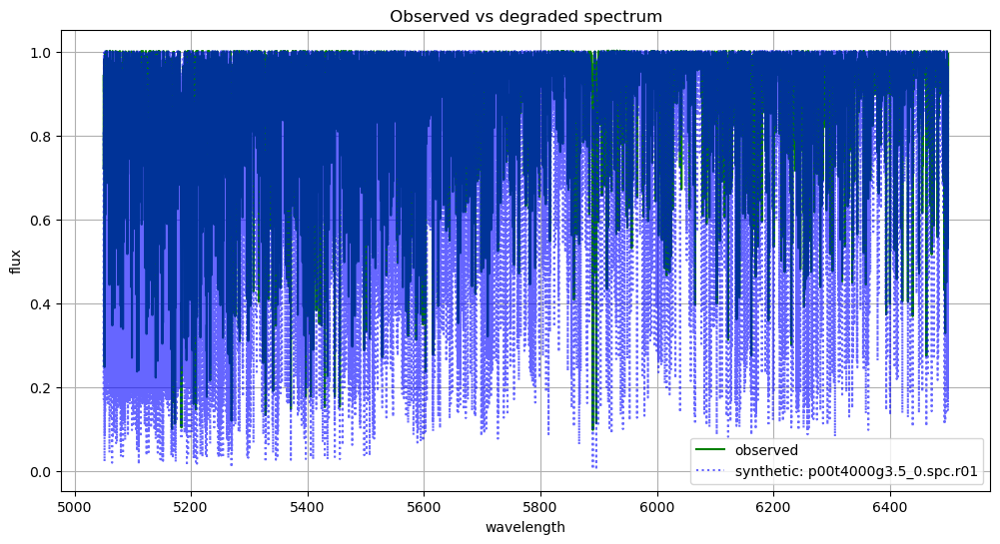

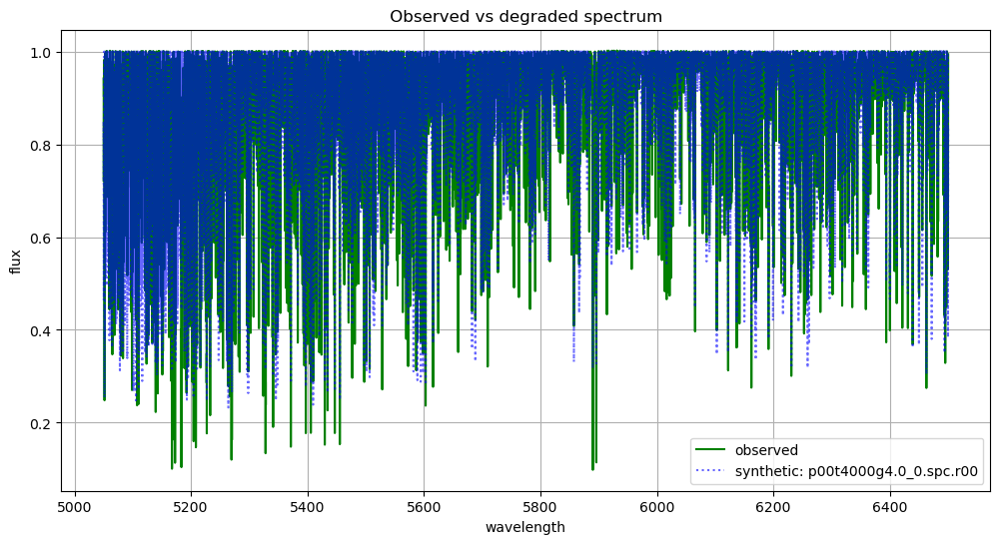

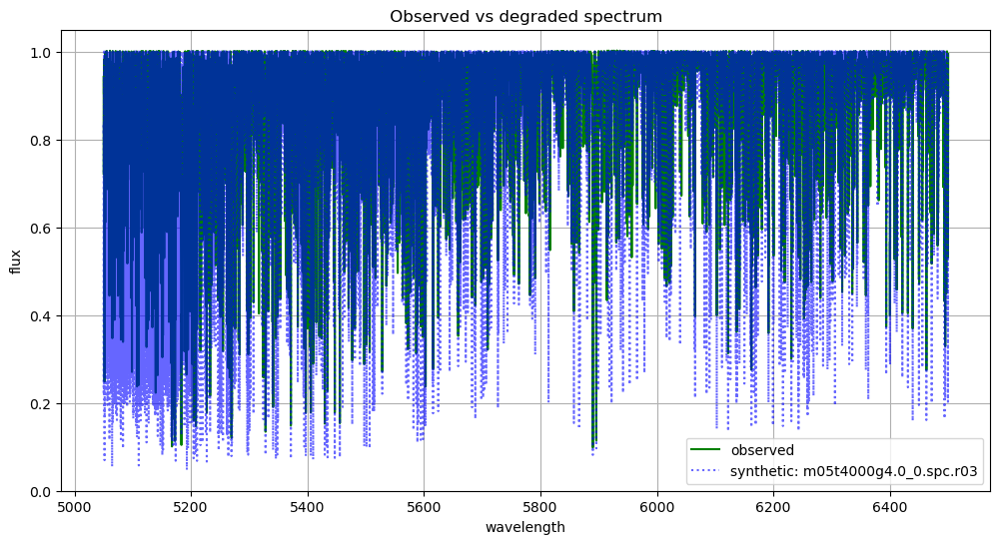

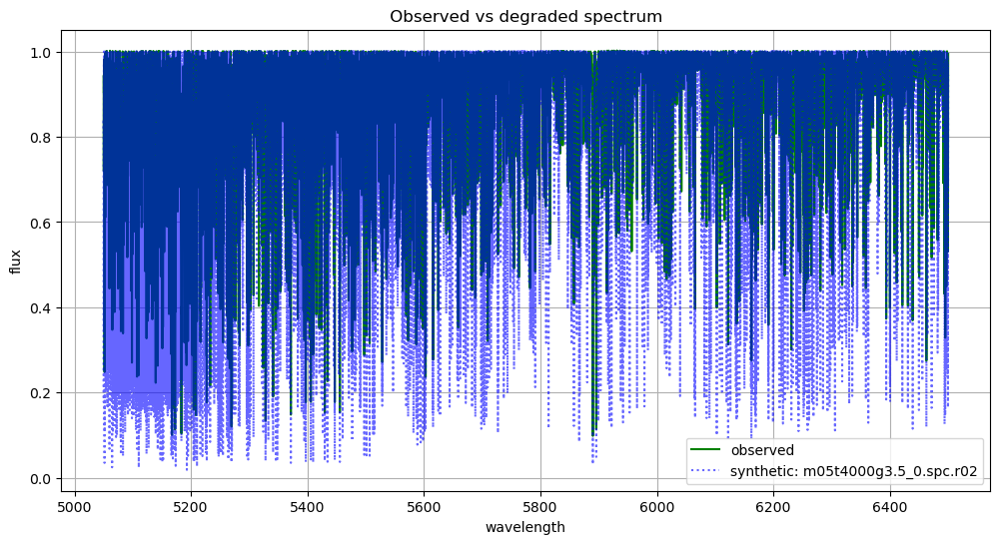

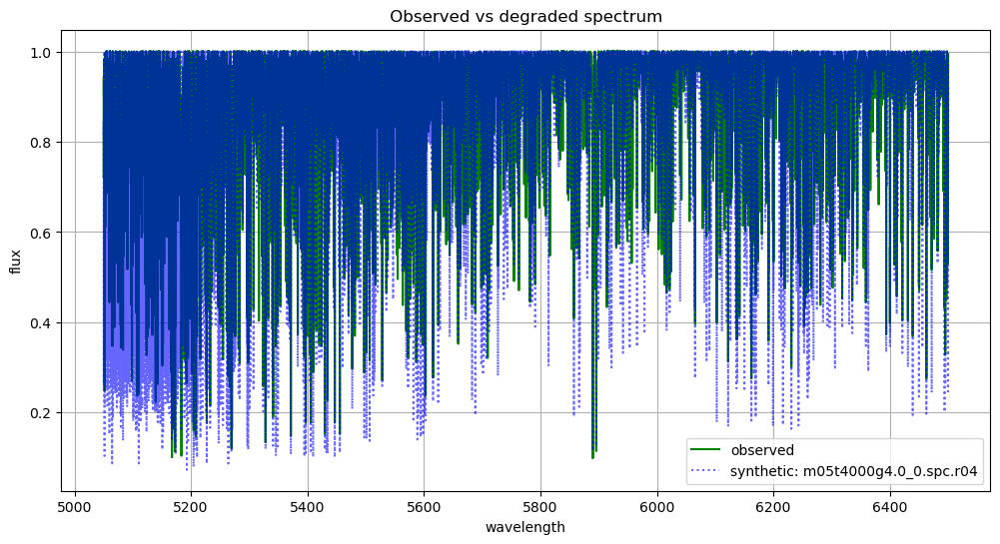

...

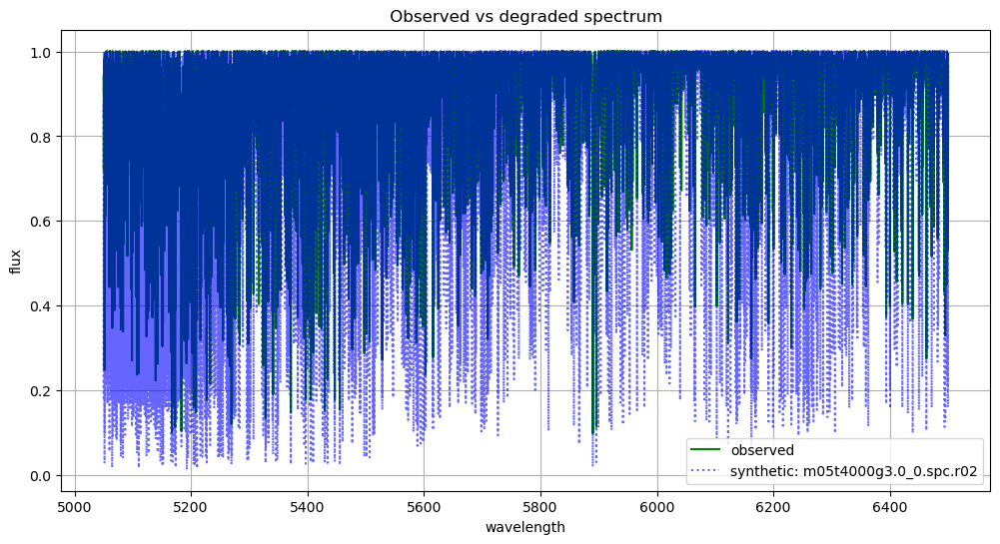

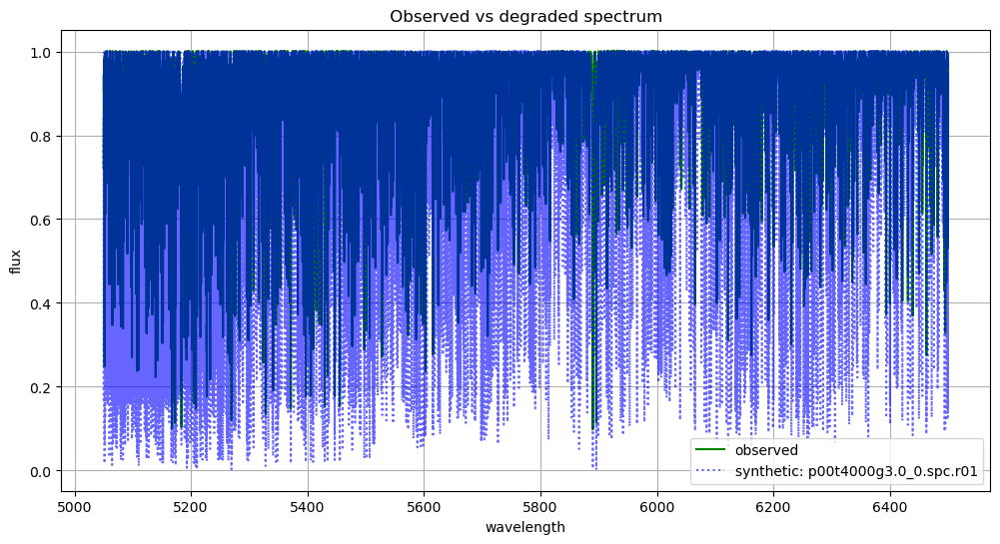

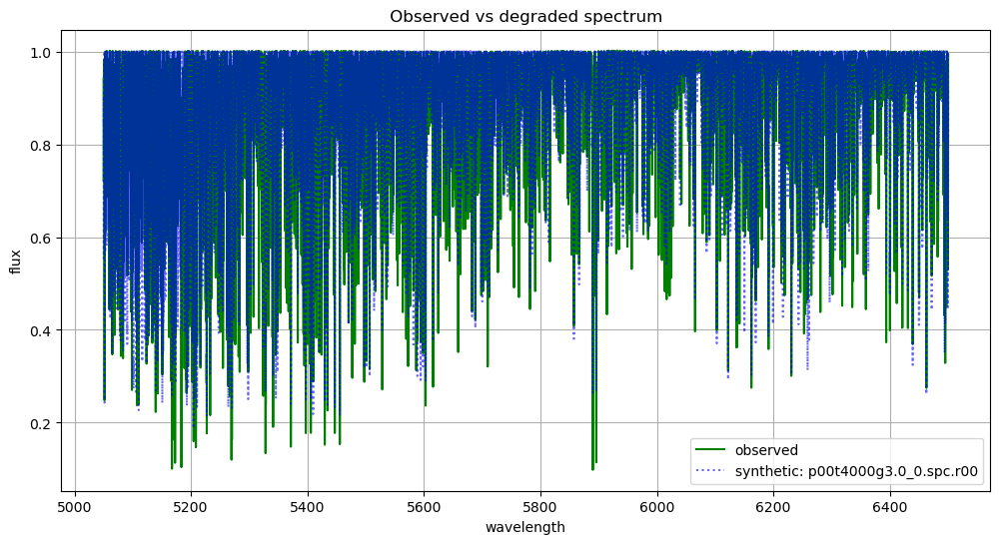

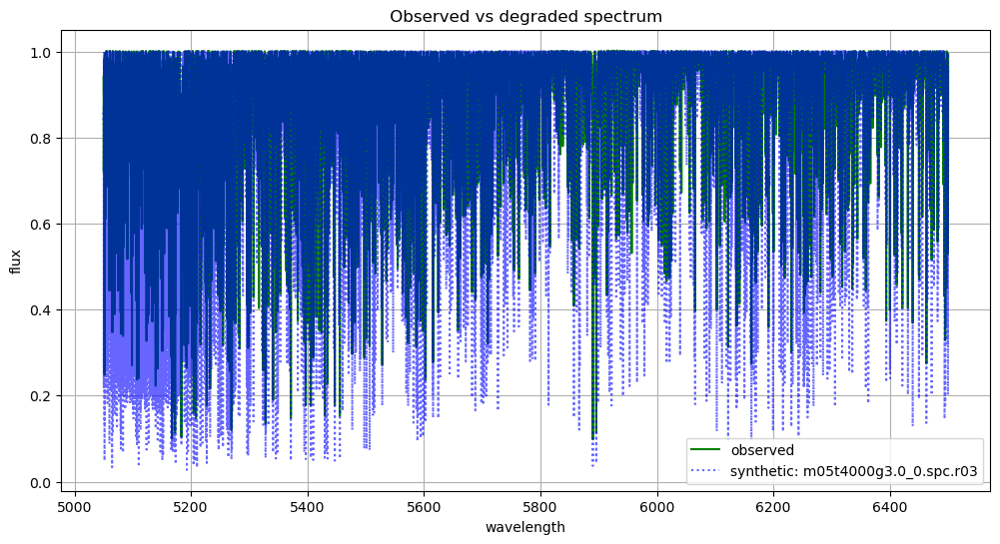

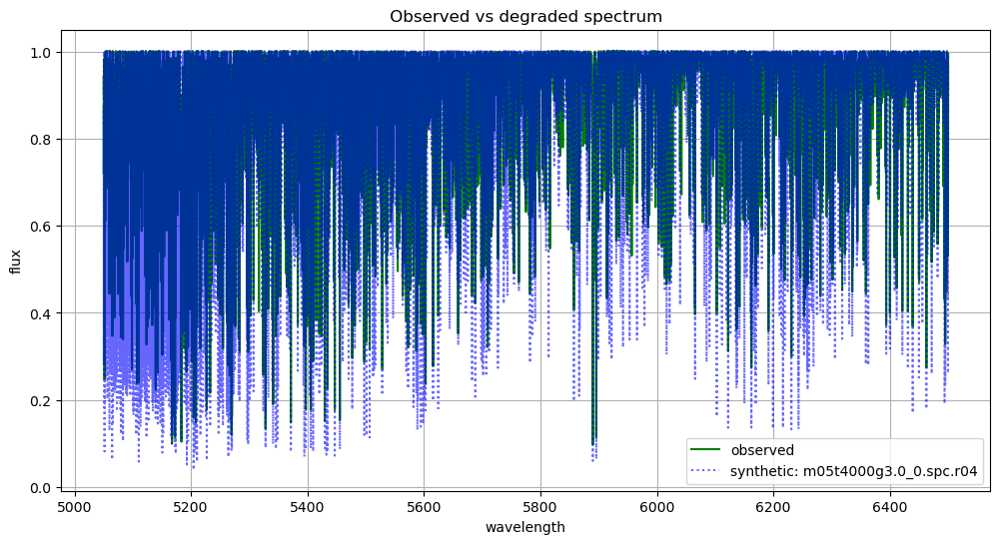

In [8]:
#task 4
from scipy.ndimage import gaussian_filter1d
import pandas as pd

obs_df = pd.read_csv(" Observed_file.csv")
R_obs = np.median(obs_df["resolving_power"])
print(f'using observed R_obs = {R_obs:.0f} ')

prop = pd.read_csv("filtered_spectra.csv")
prop.set_index("filename",inplace=True)


degraded_results = []
for entry in resultss:
    fn = entry["filename"]
    R_syn = entry["Med_R"]
    std_r = entry["std_r"]
    vsini_i = prop.loc[fn , "vsini"]
    if (R_syn > R_obs) and (vsini_i == 0):
        wl_syn, flux_syn = np.loadtxt(os.path.join(syn_dir, fn)).T
        lam0       = np.median(wl_syn)
        fwhm_syn   = lam0 / R_syn
        fwhm_obs   = lam0 / R_obs
        fwhm_kernel = np.sqrt(fwhm_obs**2 - fwhm_syn**2)
        delta = np.median(np.gradient(wl_syn))

        # Compute the convolution sigma in PIXELS:
        sigma_pix = fwhm_kernel / (2.3548 * delta)
        if sigma_pix >= 1e-6:
            flux_deg = gaussian_filter1d(flux_syn, sigma_pix)
            print(f'degrading:-{fn}')
        else:
            flux_deg = flux_syn.copy()
    else:
        sigma_pix = 0
        wl_syn, flux_syn = np.loadtxt(os.path.join(syn_dir, fn)).T
        flux_deg = flux_syn.copy()
        print(f'not degrading:-{fn}')
    win  = 101
    roll = np.lib.stride_tricks.sliding_window_view(flux_deg, win)
    pct99_9 = np.percentile(roll, 99.9, axis=1)
    pad     = (win - 1) // 2
    continuum95 = np.pad(pct99_9, pad, mode="edge")
    flux_deg_norm = flux_deg / continuum95

    # 5) Interpolate onto observed grid
    print(f'median after cont is : {np.median(flux_deg_norm)}')
    flux_interp = np.interp(wl_obs, wl_syn, flux_deg_norm)

    degraded_results.append({
        "filename": fn,
        "R_syn": R_syn,
        "R_obs": R_obs,
        "vsini": vsini_i,
        "sigma_pix": sigma_pix,
        "flux_degraded": flux_interp
    })
metadata_degraded = pd.DataFrame([ { k : r[k] for k in ( "filename" , "R_syn" , "R_obs" , "sigma_pix" , "flux_degraded" )} for r in degraded_results])
metadata_degraded.to_csv("degraded_metadata.csv",index=False)
print(f"Saved degraded_metadata.csv ({len(metadata_degraded)} entries)")

os.makedirs("degraded_spectra.csv",exist_ok = "True")
for r in degraded_results:
    outname = r["filename"].replace(".spc." , "_degraded_")
    df = pd.DataFrame({'wavelength' :wl_obs , 'flux' : r["flux_degraded"] })
    df.to_csv(os.path.join("degraded_spectra", outname),index=False)
print(f'saved degraded spectra ')

s = len(anchor_wl)*1e-6
spline_fit = UnivariateSpline( anchor_wl,anchor_flux ,s=s)
continuum = spline_fit(wl_obs)
normalized_flux = flux_obs/continuum


for r in degraded_results:
    plt.figure(figsize=(12,6))
    plt.plot( wl_obs , normalized_flux , label='observed' , color = 'green' , alpha =1.0)
    plt.plot(wl_obs , r["flux_degraded"] , label=f'synthetic: {r["filename"]}' , color = 'blue', linestyle='dotted' , alpha=0.6 )
    plt.xlabel("wavelength")
    plt.ylabel("flux")
    plt.title(" Observed vs degraded spectrum " )
    plt.grid()
    plt.legend()
    
    plt.savefig
    plt.show()
    plt.close()



In [125]:
#task 5: template matching ( chi-square method )

from scipy.signal import savgol_filter
smoothed_local_continuum = savgol_filter(flux_def_norm , 